# Test using FiftyOne - Fails to read class categories

In [129]:
import os
import shutil
import fiftyone as fo

In [130]:
yolo = 'yolov5'
# yolo_train = 'coco_data_split/train/train.json'
# yolo_val = 'coco_data_split/valid/valid.json'

coco_train = 'coco_data_split_flowers/train'
coco_val = 'coco_data_split_flowers/val'

In [131]:
fo.delete_dataset('yolo_split_flowers')

In [132]:
name = "yolo_split_flowers"
dataset_dir = yolo
splits = ["train", "val"]
dataset_type = fo.types.YOLOv5Dataset

# Load the dataset, using tags to mark the samples in each split
dataset = fo.Dataset(name)
for split in splits:
    dataset.add_dir(
        dataset_dir=dataset_dir,
        dataset_type=dataset_type,
        split=split,
        tags=split,
)

# dataset = fo.Dataset.from_dir(
#     dataset_dir=dataset_dir,
#     dataset_type=dataset_type,
#     name=name,
# )

 100% |███████████████| 1898/1898 [7.2s elapsed, 0s remaining, 511.9 samples/s]       
 100% |███████████████| 1306/1306 [2.6s elapsed, 0s remaining, 504.0 samples/s]      


In [ ]:
session = fo.launch_app(dataset, auto=False)
session.open_tab()

Session launched. Run `session.show()` to open the App in a cell output.


<IPython.core.display.Javascript object>

In [ ]:
print(len(dataset.default_classes))

85


In [ ]:
export_dir = "coco_test"
label_field = "ground_truth"  # for example

# Export the dataset
dataset.export(
    export_dir=export_dir,
    dataset_type=fo.types.COCODetectionDataset,
    label_field=label_field,
)

 100% |███████████████| 3204/3204 [22.2s elapsed, 0s remaining, 74.4 samples/s]       


In [ ]:
import fiftyone.zoo as foz

dataset2 = foz.load_zoo_dataset("coco-2017", split="validation")
dataset2.name = "coco-2017-validation-example"

 100% |██████|    1.9Gb/1.9Gb [15.6s elapsed, 0s remaining, 115.2Mb/s]      
Extracting annotations to '/Users/niko/fiftyone/coco-2017/raw/instances_val2017.json'
 100% |██████|    6.1Gb/6.1Gb [50.0s elapsed, 0s remaining, 121.6Mb/s]      
Extracting images to '/Users/niko/fiftyone/coco-2017/validation/data'
Writing annotations to '/Users/niko/fiftyone/coco-2017/validation/labels.json'
Dataset info written to '/Users/niko/fiftyone/coco-2017/info.json'
Loading 'coco-2017' split 'validation'
 100% |███████████████| 5000/5000 [10.8s elapsed, 0s remaining, 440.3 samples/s]      
Dataset 'coco-2017-validation' created


In [ ]:
print(len(dataset2.default_classes))

91


In [ ]:
export_dir = "yolov5-coco-2017"
label_field = "ground_truth"  # for example

# The splits to export
splits = ["validation"]

# All splits must use the same classes list
classes = dataset2.default_classes

# Export the splits
for split in splits:
    split_view = dataset2.match_tags(split)
    split_view.export(
        export_dir=export_dir,
        dataset_type=fo.types.YOLOv5Dataset,
        label_field=label_field,
        split=split,
        classes=classes,
    )

 100% |███████████████| 5000/5000 [13.2s elapsed, 0s remaining, 569.2 samples/s]      


In [ ]:
fo.delete_dataset('yolov5_coco_2017')

In [ ]:
name = "yolov5_coco_2017"
dataset_dir = 'yolov5-coco-2017'
splits = ["validation"]
dataset_type = fo.types.YOLOv5Dataset

# Load the dataset, using tags to mark the samples in each split
dataset3 = fo.Dataset(name)
for split in splits:
    dataset.add_dir(
        dataset_dir=dataset_dir,
        dataset_type=dataset_type,
        split=split,
        tags=split,
)

# dataset = fo.Dataset.from_dir(
#     dataset_dir=dataset_dir,
#     dataset_type=dataset_type,
#     name=name,
# )

 100% |███████████████| 4952/4952 [8.3s elapsed, 0s remaining, 591.0 samples/s]       


In [ ]:
session = fo.launch_app(dataset3, auto=False)
session.open_tab()

Session launched. Run `session.show()` to open the App in a cell output.


<IPython.core.display.Javascript object>

# Fix IDs in YoloV5 format labels

In [ ]:
import os
import numpy as np

In [ ]:
root_dir = "yolov5train/labels/train/"

for file in os.listdir(root_dir):
  if file.endswith(".txt"):
    # print(file)
    rel_path = os.path.join(root_dir, file)
    with open(rel_path, 'r') as file:
      data = file.readlines()
    if len(data[0]) < 20:
        pass
    else:
        df = pd.read_csv(rel_path, delimiter=' ', header=None)
        df[0] = df[0].apply(lambda x: int(float(x)))
        df.to_csv(rel_path, sep=' ', index=False, header=False, float_format='%.4f')

In [ ]:
root_dir = "yolov5val/labels/train/"

for file in os.listdir(root_dir):
  if file.endswith(".txt"):
    # print(file)
    rel_path = os.path.join(root_dir, file)
    with open(rel_path, 'r') as file:
      data = file.readlines()
    if len(data[0]) < 20:
        pass
    else:
        df = pd.read_csv(rel_path, delimiter=' ', header=None)
        df[0] = df[0].apply(lambda x: int(float(x)))
        df.to_csv(rel_path, sep=' ', index=False, header=False, float_format='%.4f')

# Test using PyLabel

In [1]:
from pylabel import importer
from pylabel import *

from pathlib import PurePath

import yaml

In [ ]:
#Import the data from a YAML file and convert it to a dataset
data0 = importer.ImportYoloV5WithYaml(yaml_file="yolov5train/dataset.yaml", 
                     path_to_annotations=None, 
                     image_ext='jpg',
                     name_of_annotations_folder="labels")

Importing YOLO files...:   0%|          | 0/21 [00:00<?, ?it/s]

Importing YOLO files...: 100%|█████████▉| 1897/1898 [01:21<00:00, 24.26it/s]/Users/niko/miniconda3/envs/ai7/lib/python3.11/site-packages/pylabel/importer.py:422: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.fillna("", inplace=True)
Importing YOLO files...: 100%|██████████| 1898/1898 [01:21<00:00, 23.27it/s]


ValueError: max() arg is an empty sequence

In [2]:
path_to_annotations_train = "yolov5train/labels/train/"
path_to_images_train = "../../images/train/"
path_to_annotations_val = "yolov5val/labels/train/"
path_to_images_val = "../../images/train/"

yoloclasses = ['Acrididae', 'Agapeta', 'Agapeta hamana', 'Animalia', 'Anisopodidae', 'Aphididae', 'Apidae', 'Arachnida', 'Araneae', 'Arctiidae', 'Auchenorrhyncha indet.', 'Baetidae', 'Cabera', 'Caenidae', 'Carabidae', 'Cecidomyiidae', 'Ceratopogonidae', 'Cercopidae', 'Chironomidae', 'Chrysomelidae', 'Chrysopidae', 'Chrysoteuchia culmella', 'Cicadellidae', 'Coccinellidae', 'Coleophoridae', 'Coleoptera', 'Collembola', 'Corixidae', 'Crambidae', 'Culicidae', 'Curculionidae', 'Dermaptera', 'Diptera', 'Eilema', 'Empididae', 'Ephemeroptera', 'Erebidae', 'Fanniidae', 'Formicidae', 'Gastropoda', 'Gelechiidae', 'Geometridae', 'Hemiptera', 'Hydroptilidae', 'Hymenoptera', 'Ichneumonidae', 'Idaea', 'Insecta', 'Lepidoptera', 'Leptoceridae', 'Limoniidae', 'Lomaspilis marginata', 'Miridae', 'Mycetophilidae', 'Nepticulidae', 'Neuroptera', 'Noctuidae', 'Notodontidae', 'Object', 'Opiliones', 'Orthoptera', 'Panorpa', 'Panorpa germanica', 'Panorpa vulgaris', 'Parasitica indet.', 'Plutellidae', 'Psocodea', 'Psychodidae', 'Pterophoridae', 'Pyralidae', 'Pyrausta', 'Sciaridae', 'Sepsidae', 'Spilosoma', 'Staphylinidae', 'Stratiomyidae', 'Syrphidae', 'Tettigoniidae', 'Tipulidae', 'Tomoceridae', 'Tortricidae', 'Trichoptera', 'Triodia sylvina', 'Yponomeuta', 'Yponomeutidae']
dataset_train = importer.ImportYoloV5(path=path_to_annotations_train, path_to_images=path_to_images_train, cat_names=yoloclasses,
    img_ext="jpg", name="insect_train")
dataset_val = importer.ImportYoloV5(path=path_to_annotations_val, path_to_images=path_to_images_val, cat_names=yoloclasses,
    img_ext="jpg", name="insect_val")

Importing YOLO files...: 100%|██████████| 1899/1899 [01:20<00:00, 25.12it/s]/Users/niko/miniconda3/envs/ai7/lib/python3.11/site-packages/pylabel/importer.py:422: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.fillna("", inplace=True)
Importing YOLO files...: 100%|█████████▉| 1305/1306 [00:54<00:00, 24.08it/s]/Users/niko/miniconda3/envs/ai7/lib/python3.11/site-packages/pylabel/importer.py:422: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.fillna("", inplace=True)
Importing YOLO files...: 100%|██████████| 1306/1306 [00:55<00:00, 23.72it/s]


In [3]:
print(f"Number of images: {dataset_train.analyze.num_images}")
print(f"Number of classes: {dataset_train.analyze.num_classes}")
print(f"Classes:{dataset_train.analyze.classes}")
print(f"Class counts:\n{dataset_train.analyze.class_counts}")

Number of images: 1898
Number of classes: 83
Classes:['Acrididae', 'Agapeta', 'Agapeta hamana', 'Animalia', 'Anisopodidae', 'Aphididae', 'Apidae', 'Arachnida', 'Araneae', 'Arctiidae', 'Auchenorrhyncha indet.', 'Baetidae', 'Cabera', 'Caenidae', 'Carabidae', 'Cecidomyiidae', 'Ceratopogonidae', 'Cercopidae', 'Chironomidae', 'Chrysomelidae', 'Chrysopidae', 'Chrysoteuchia culmella', 'Cicadellidae', 'Coccinellidae', 'Coleophoridae', 'Coleoptera', 'Collembola', 'Corixidae', 'Crambidae', 'Culicidae', 'Curculionidae', 'Dermaptera', 'Diptera', 'Eilema', 'Empididae', 'Ephemeroptera', 'Erebidae', 'Fanniidae', 'Formicidae', 'Gastropoda', 'Gelechiidae', 'Geometridae', 'Hemiptera', 'Hydroptilidae', 'Hymenoptera', 'Ichneumonidae', 'Idaea', 'Insecta', 'Lepidoptera', 'Leptoceridae', 'Limoniidae', 'Lomaspilis marginata', 'Miridae', 'Mycetophilidae', 'Nepticulidae', 'Neuroptera', 'Noctuidae', 'Notodontidae', 'Object', 'Opiliones', 'Orthoptera', 'Panorpa germanica', 'Panorpa vulgaris', 'Parasitica indet.',

In [4]:
print(f"Number of images: {dataset_val.analyze.num_images}")
print(f"Number of classes: {dataset_val.analyze.num_classes}")
print(f"Classes:{dataset_val.analyze.classes}")
print(f"Class counts:\n{dataset_val.analyze.class_counts}")

Number of images: 1306
Number of classes: 73
Classes:['Acrididae', 'Agapeta hamana', 'Animalia', 'Aphididae', 'Apidae', 'Arachnida', 'Araneae', 'Arctiidae', 'Auchenorrhyncha indet.', 'Baetidae', 'Caenidae', 'Cecidomyiidae', 'Ceratopogonidae', 'Chironomidae', 'Chrysomelidae', 'Chrysopidae', 'Chrysoteuchia culmella', 'Cicadellidae', 'Coleophoridae', 'Coleoptera', 'Collembola', 'Corixidae', 'Crambidae', 'Culicidae', 'Curculionidae', 'Dermaptera', 'Diptera', 'Eilema', 'Empididae', 'Ephemeroptera', 'Erebidae', 'Fanniidae', 'Formicidae', 'Gastropoda', 'Geometridae', 'Hemiptera', 'Hydroptilidae', 'Hymenoptera', 'Ichneumonidae', 'Idaea', 'Insecta', 'Lepidoptera', 'Leptoceridae', 'Limoniidae', 'Lomaspilis marginata', 'Miridae', 'Mycetophilidae', 'Neuroptera', 'Noctuidae', 'Notodontidae', 'Object', 'Opiliones', 'Orthoptera', 'Panorpa', 'Panorpa germanica', 'Panorpa vulgaris', 'Parasitica indet.', 'Plutellidae', 'Psychodidae', 'Pterophoridae', 'Pyrausta', 'Sciaridae', 'Sepsidae', 'Staphylinidae',

In [5]:
len(set(dataset_train.analyze.classes + dataset_val.analyze.classes))

85

In [6]:
set(dataset_val.analyze.classes) - set(dataset_train.analyze.classes)

{'Panorpa', 'Sciaridae'}

In [7]:
dataset_val.df[dataset_val.df["cat_name"] == "Panorpa"]

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_iscrowd,ann_keypoints,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
8557,../../images/train/,290_20210828102807.jpg,,1052,3280,2464,3,,2955.116,842.9344,...,,,,,,61,Panorpa,,,1


In [8]:
dataset_val.df[dataset_val.df["cat_name"] == "Sciaridae"]

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_iscrowd,ann_keypoints,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
3932,../../images/train/,126_20200821000342.jpg,,438,3280,2464,3,,478.88,1069.0064,...,,,,,,71,Sciaridae,,,1


In [9]:
from IPython.display import Image, display

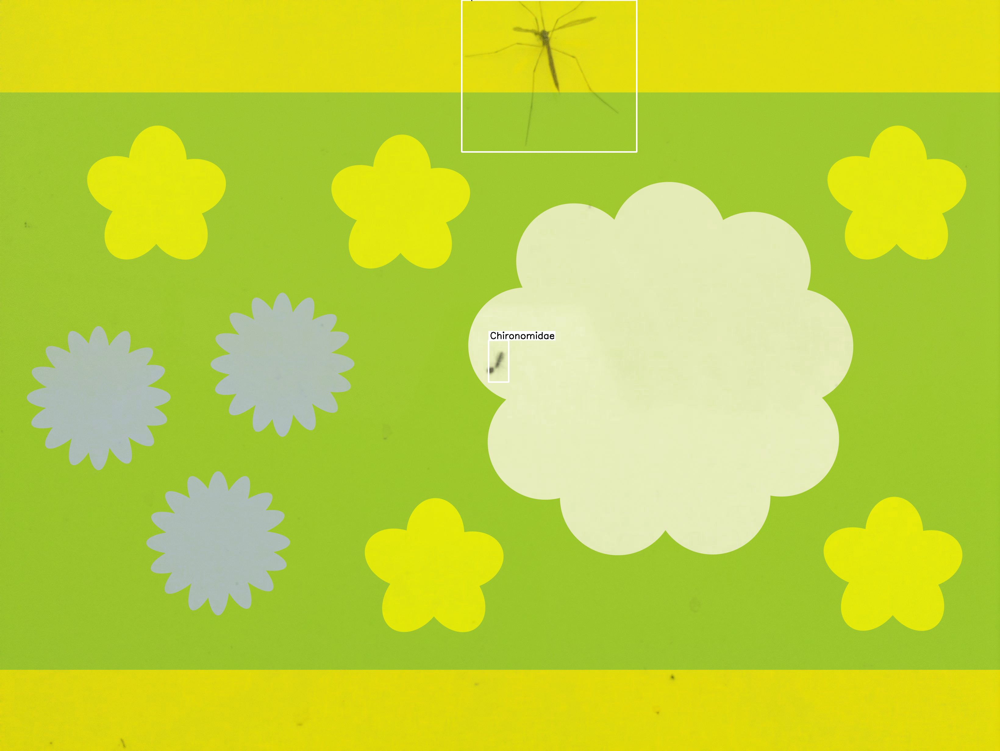

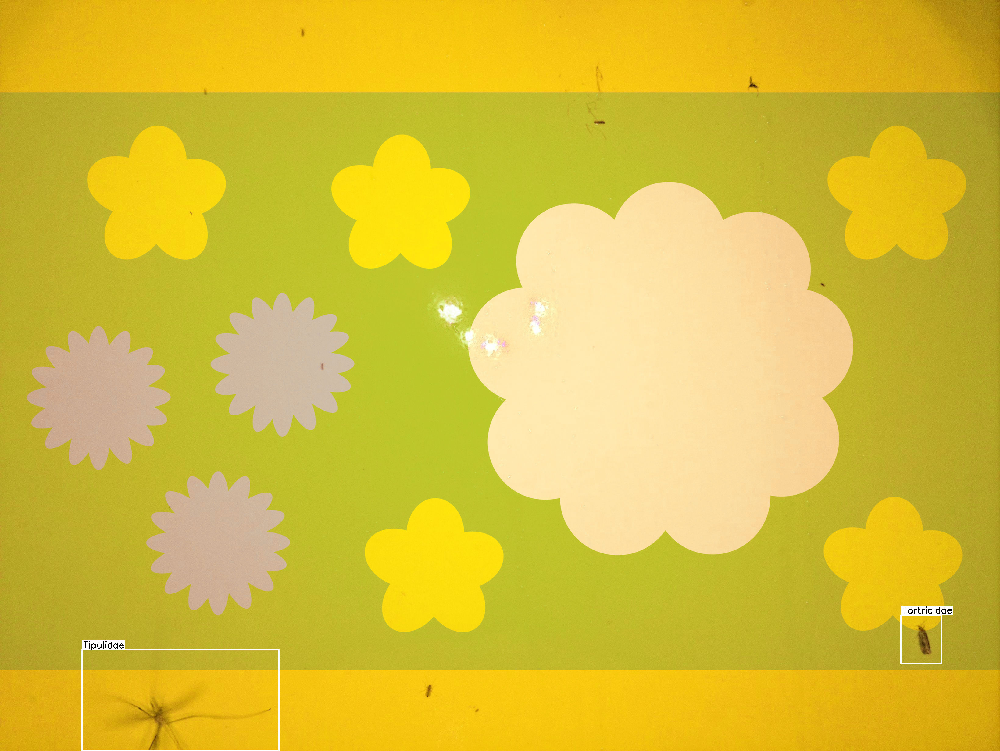

In [10]:
display(dataset_train.visualize.ShowBoundingBoxes(100))
display(dataset_train.visualize.ShowBoundingBoxes(30))

In [11]:
dataset_val.df[dataset_val.df["img_id"] == 2] #ID in annotations 2302

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_iscrowd,ann_keypoints,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
14,../../images/train/,271_20210923004306.jpg,,2,3280,2464,3,,1599.164,1678.9696,...,,,,,,50,Limoniidae,,,1
15,../../images/train/,271_20210923004306.jpg,,2,3280,2464,3,,299.136,663.9248,...,,,,,,32,Diptera,,,1


In [12]:
dataset_val.df[dataset_val.df["img_id"] == 35] #ID in annotations 2305

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_iscrowd,ann_keypoints,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
254,../../images/train/,271_20210923010213.jpg,,35,3280,2464,3,,1599.164,1669.976,...,,,,,,78,Tipulidae,,,1
255,../../images/train/,271_20210923010213.jpg,,35,3280,2464,3,,297.824,661.9536,...,,,,,,32,Diptera,,,1


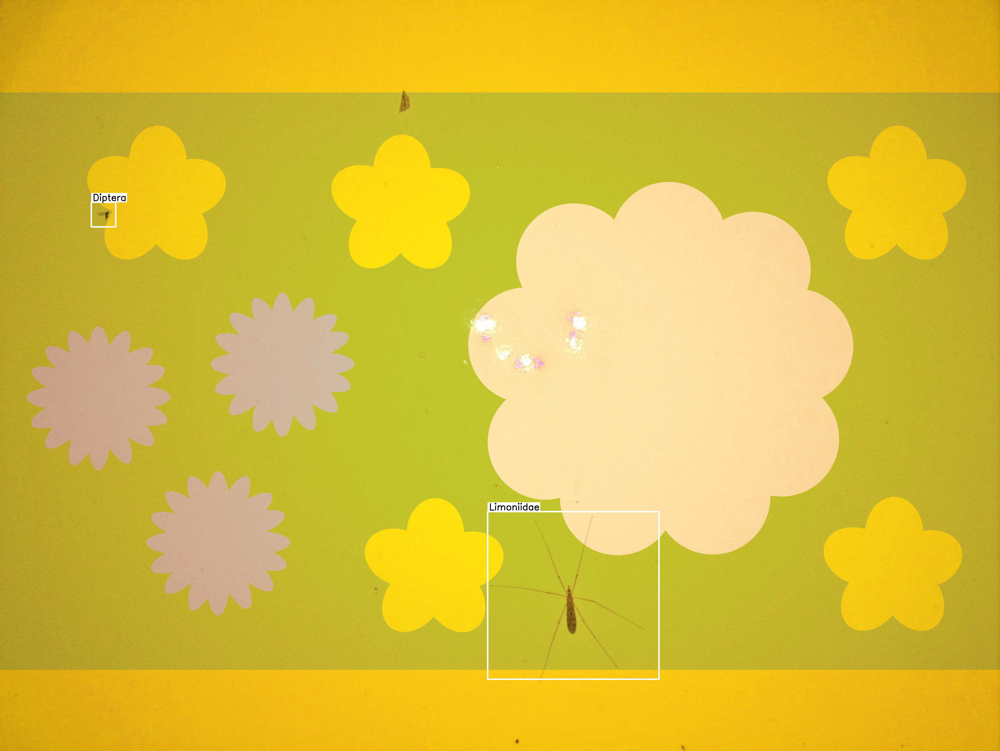

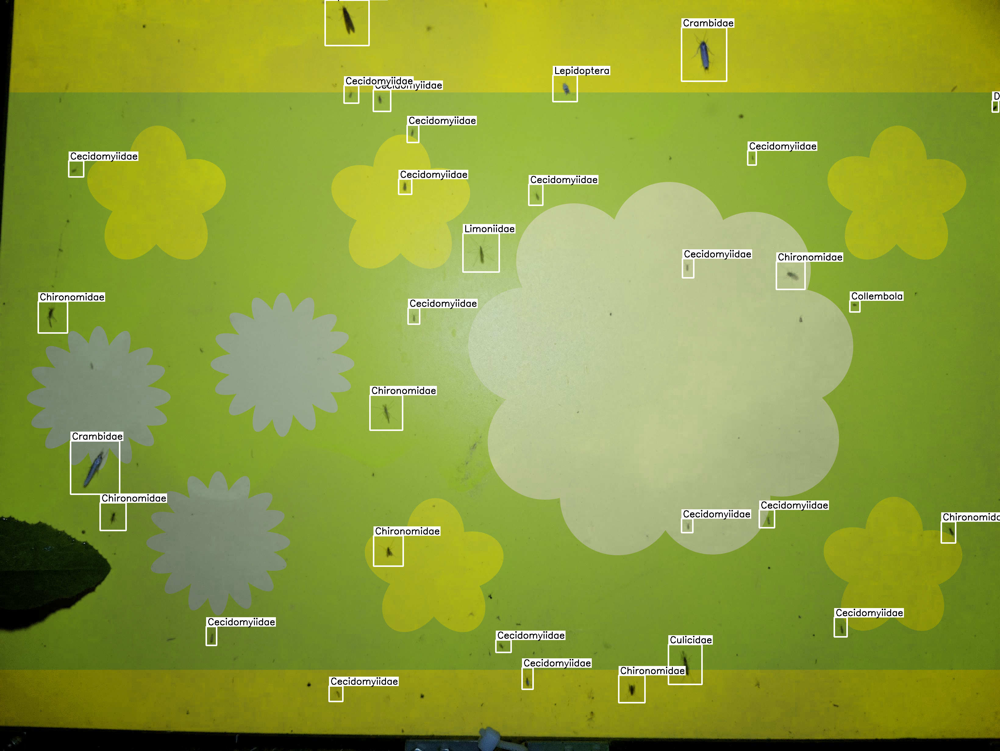

In [13]:
display(dataset_val.visualize.ShowBoundingBoxes(2)) #THESE ARE SAME 2, 35
display(dataset_val.visualize.ShowBoundingBoxes(30))

In [16]:
dataset_train.export.ExportToCoco('coco_data_split_flowers_yolo/train.json', cat_id_index=1)
dataset_val.export.ExportToCoco('coco_data_split_flowers_yolo/val.json', cat_id_index=1)

/Users/niko/miniconda3/envs/ai7/lib/python3.11/site-packages/pylabel/exporter.py:767: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df = df.replace(r"^\s*$", np.nan, regex=True)
Exporting to COCO file...: 100%|██████████| 9781/9781 [00:01<00:00, 6139.70it/s] 


['coco_data_split_flowers/val.json']